In [7]:
college = read.csv("College.csv")

In [3]:
# Set the first column values to be the row names
rownames(college) = college[,1]

In [5]:
# Remove the first column
college = college[,-1]

In [6]:
head(college)

,Private,Apps,Accept,Enroll,Top10perc,Top25perc,F.Undergrad,P.Undergrad,Outstate,Room.Board,Books,Personal,PhD,Terminal,S.F.Ratio,perc.alumni,Expend,Grad.Rate
Abilene Christian University,Yes,1660,1232,721,23,52,2885,537,7440,3300,450,2200,70,78,18.1,12,7041,60
Adelphi University,Yes,2186,1924,512,16,29,2683,1227,12280,6450,750,1500,29,30,12.2,16,10527,56
Adrian College,Yes,1428,1097,336,22,50,1036,99,11250,3750,400,1165,53,66,12.9,30,8735,54
Agnes Scott College,Yes,417,349,137,60,89,510,63,12960,5450,450,875,92,97,7.7,37,19016,59
Alaska Pacific University,Yes,193,146,55,16,44,249,869,7560,4120,800,1500,76,72,11.9,2,10922,15
Albertson College,Yes,587,479,158,38,62,678,41,13500,3335,500,675,67,73,9.4,11,9727,55


In [8]:
summary(college)

                            X       Private        Apps           Accept     
 Abilene Christian University:  1   No :212   Min.   :   81   Min.   :   72  
 Adelphi University          :  1   Yes:565   1st Qu.:  776   1st Qu.:  604  
 Adrian College              :  1             Median : 1558   Median : 1110  
 Agnes Scott College         :  1             Mean   : 3002   Mean   : 2019  
 Alaska Pacific University   :  1             3rd Qu.: 3624   3rd Qu.: 2424  
 Albertson College           :  1             Max.   :48094   Max.   :26330  
 (Other)                     :771                                            
     Enroll       Top10perc       Top25perc      F.Undergrad   
 Min.   :  35   Min.   : 1.00   Min.   :  9.0   Min.   :  139  
 1st Qu.: 242   1st Qu.:15.00   1st Qu.: 41.0   1st Qu.:  992  
 Median : 434   Median :23.00   Median : 54.0   Median : 1707  
 Mean   : 780   Mean   :27.56   Mean   : 55.8   Mean   : 3700  
 3rd Qu.: 902   3rd Qu.:35.00   3rd Qu.: 69.0   3rd Qu.:

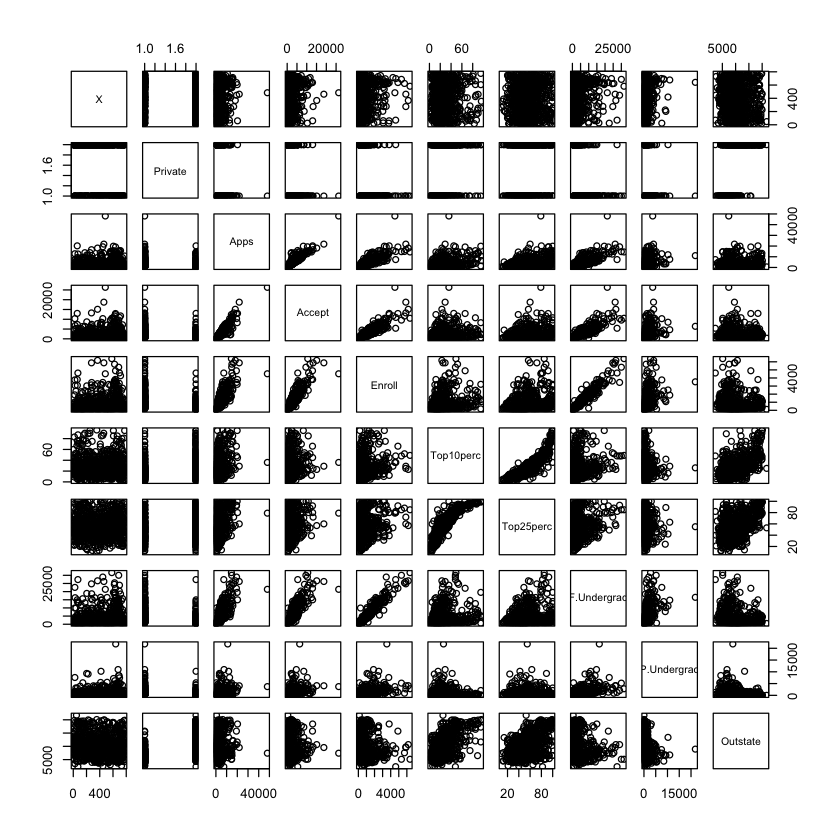

In [9]:
pairs(college[, 1:10])

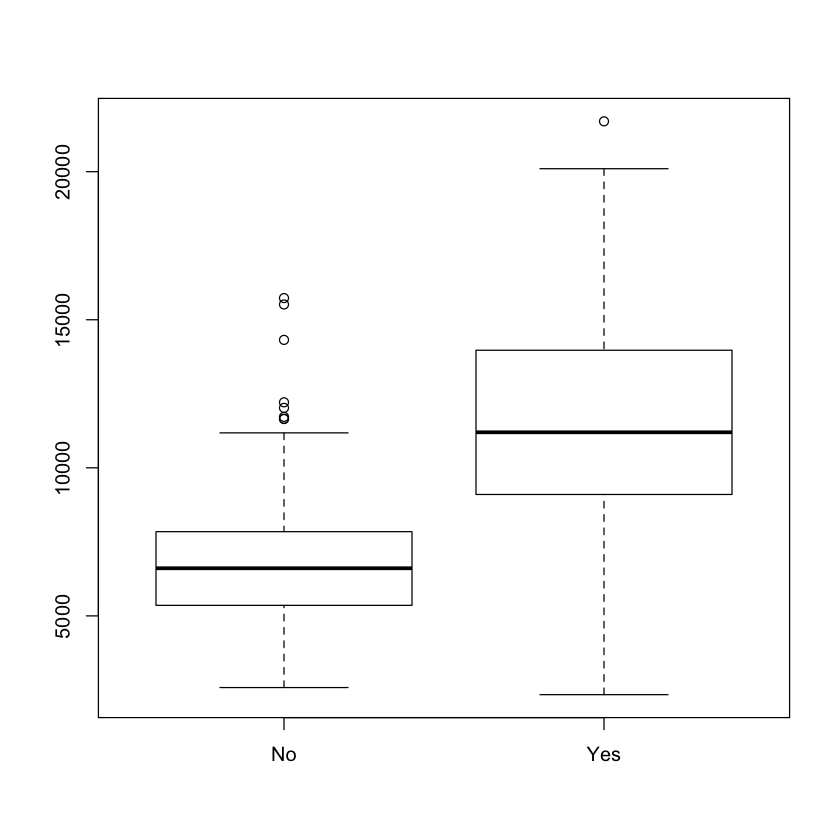

In [59]:
plot(college$Private, college$Outstate)
# Out of state tuition is much higher for private colleges

In [12]:
Elite = rep("NO", nrow(college))
Elite[college$Top10perc > 50] = 'YES'
Elite = as.factor(Elite)
college = data.frame(college, Elite)

In [17]:
summary(college$Elite)

NO YES 
699  78

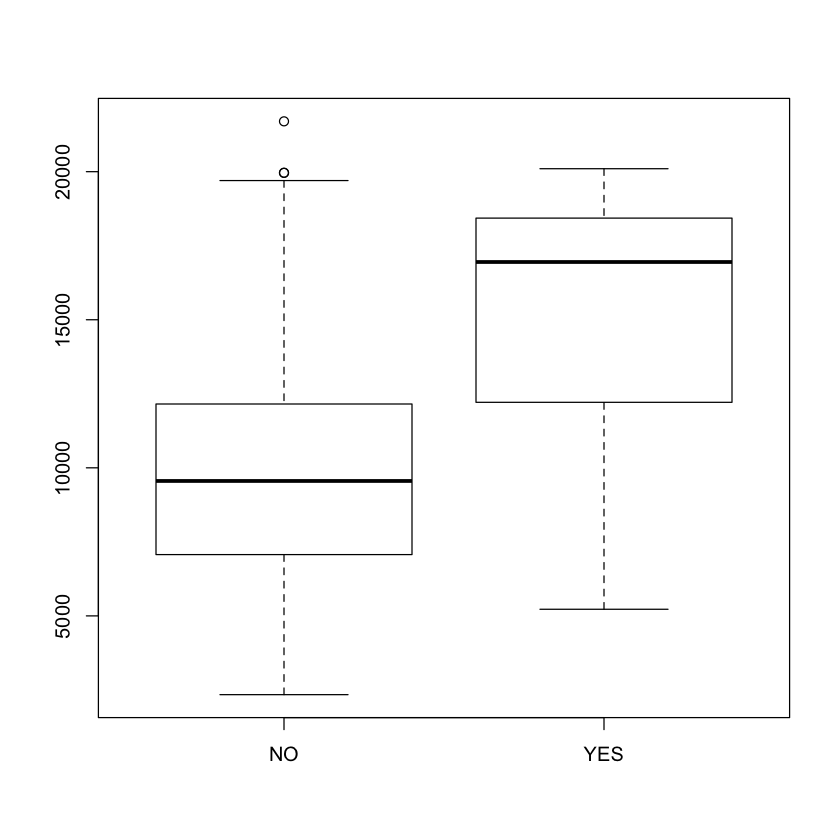

In [58]:
plot(college$Elite, college$Outstate)
# The out of state tuition is much higher for elite colleges

In [22]:
# Acceptance rate
AdmitRate = college$Accept/college$Apps
college = data.frame(college, AdmitRate)

In [45]:
# Find colleges with the lowest Admit Rate
lowest_20 = college[order(college$AdmitRate),][1:20,]
lowest_20$X

[1] Princeton University                  Harvard University                   
 [3] Yale University                       Amherst College                      
 [5] Brown University                      Georgetown University                
 [7] Dartmouth College                     Duke University                      
 [9] Columbia University                   Williams College                     
[11] Bowdoin College                       Huron University                     
[13] Washington and Lee University         Spelman College                      
[15] Massachusetts Institute of Technology University of Virginia               
[17] Talladega College                     Rowan College of New Jersey          
[19] Stockton College of New Jersey        Davidson College                     
777 Levels: Abilene Christian University Adelphi University ... York College of Pennsylvania

In [52]:
# Colleges with the highest admit rate
highest_20 = college[order(-college$AdmitRate),][1:20,]
highest_20$X

[1] Emporia State University               
 [2] Mayville State University              
 [3] MidAmerica Nazarene College            
 [4] Southwest Baptist University           
 [5] University of Wisconsin-Superior       
 [6] Wayne State College                    
 [7] Arkansas Tech University               
 [8] Southwestern Adventist College         
 [9] Pikeville College                      
[10] Mount Marty College                    
[11] Oklahoma Christian University          
[12] University of Sci. and Arts of Oklahoma
[13] Benedictine College                    
[14] Delta State University                 
[15] Kansas Wesleyan University             
[16] Spring Arbor College                   
[17] University of Missouri at Rolla        
[18] University of Dubuque                  
[19] Albertus Magnus College                
[20] University of Arkansas at Fayetteville 
777 Levels: Abilene Christian University Adelphi University ... York College of Pennsylvania

[1] -0.3183339

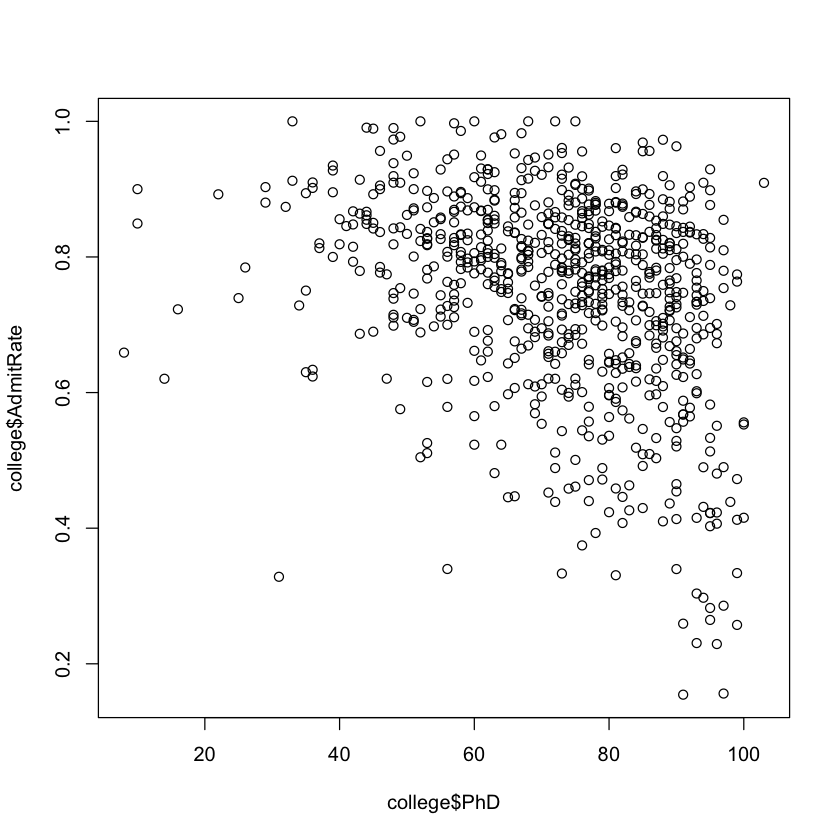

In [56]:
# Is there a relationship between the % of faculty with PhDs and the acceptance rate
plot(college$PhD, college$AdmitRate)
cor(college$PhD, college$AdmitRate)

# A weak correlation is seen to exist. as the % of professors with PhDs increase, the admit
# rate for the college decreases

[1] -0.4269421

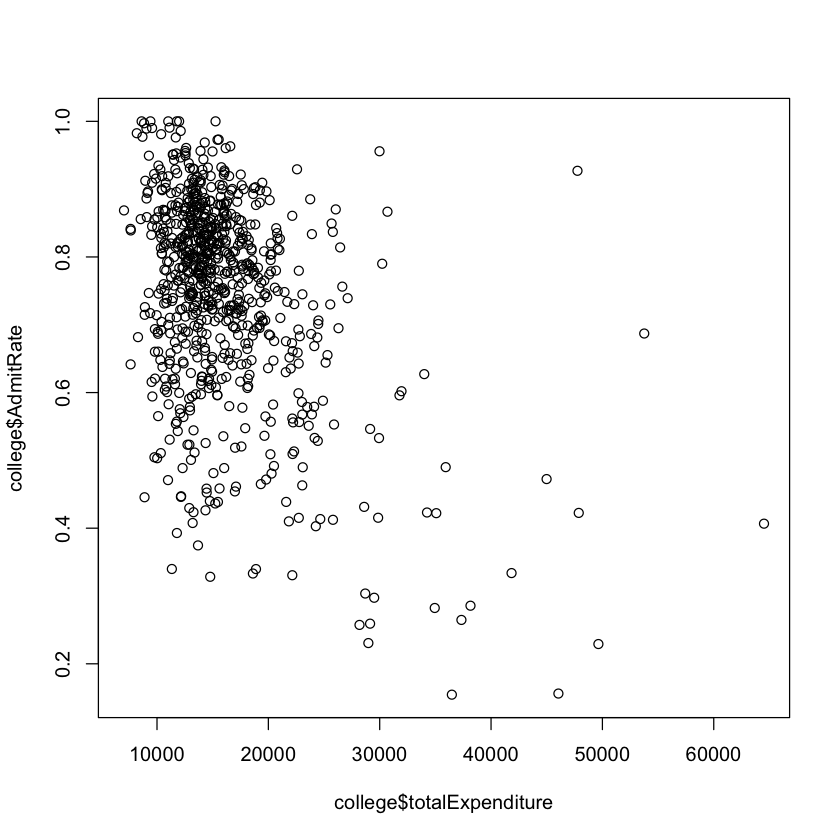

In [63]:
# Is Total spending correlated with Admit Rate?
# I need to conditionally include out of state tuition here
totalExpenditure = college$Room.Board + college$Books + college$Personal + college$Expend 
college = data.frame(college, totalExpenditure)

plot(college$totalExpenditure, college$AdmitRate)
cor(college$totalExpenditure, college$AdmitRate)
# Cheap colleges tend to have a higher admit rate

[1] 0.3050379

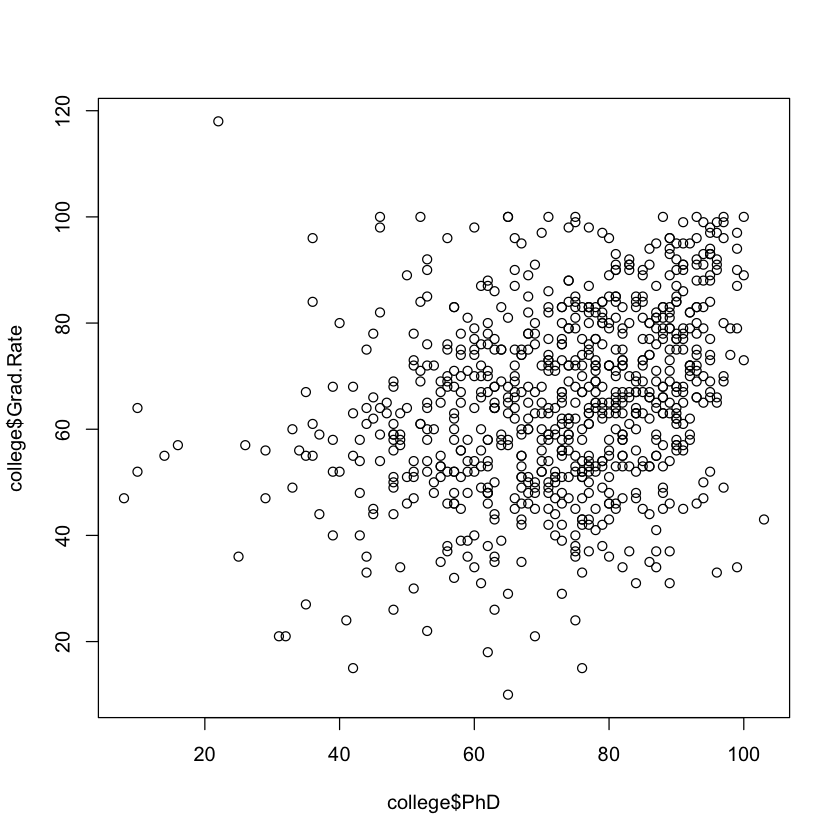

In [65]:
# Relationship between graduation rate and percentage of faculty with PhDs
plot(college$PhD, college$Grad.Rate)
cor(college$PhD, college$Grad.Rate)
# slight correlation

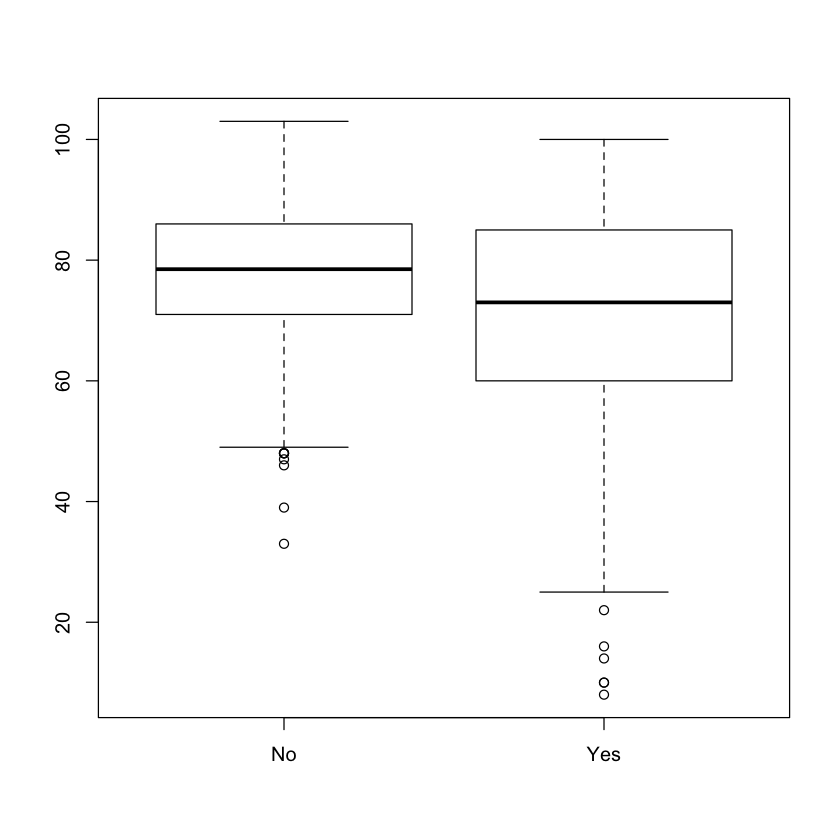

In [67]:
# Do Private colleges have a higher percentage of PhDs?
plot(college$Private, college$PhD)
# Public colleges seem to have a slightly higher percentage of PhDs

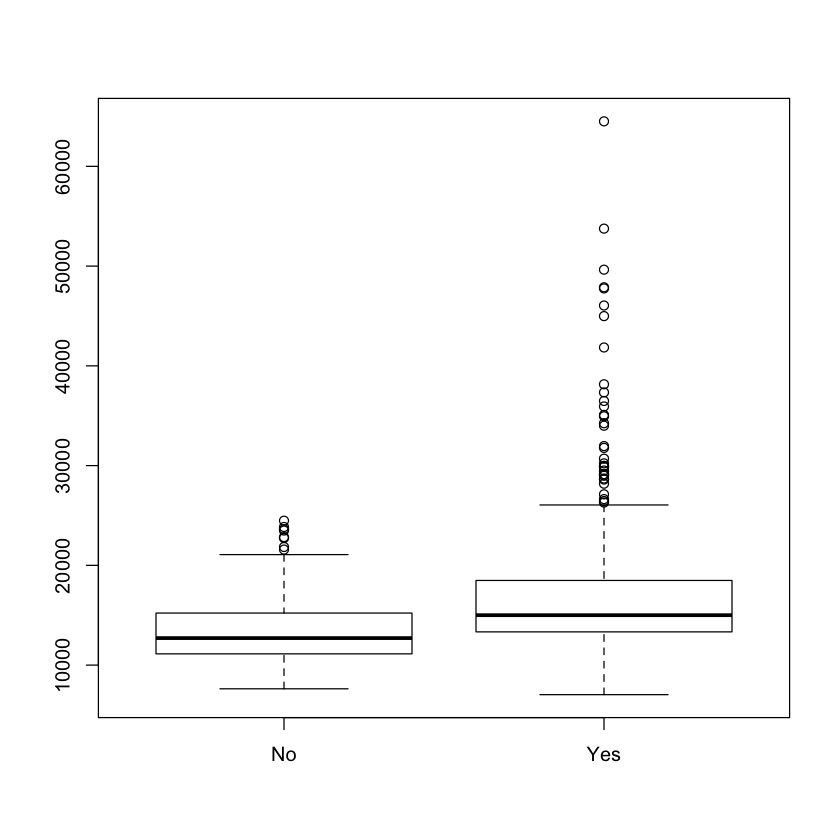

In [70]:
# Are Private colleges more expensive?
# Yes it does seem so
plot(college$Private, college$totalExpenditure)

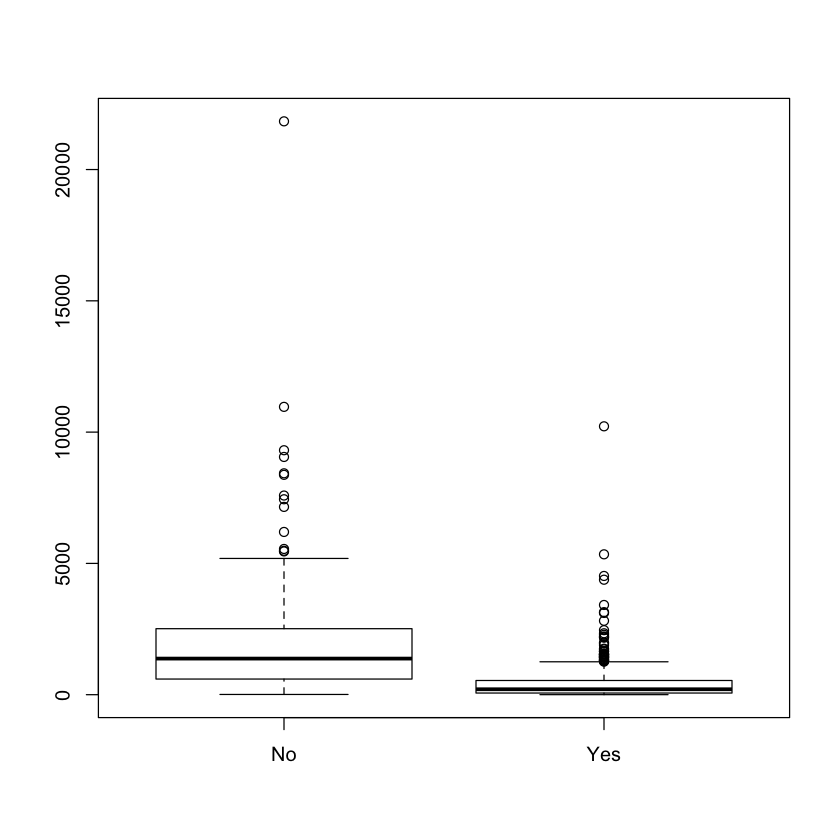

In [72]:
# Do public colleges have a higher percentage of part time students?
# Public colleges have a much higher percentage of part time students
plot(college$Private, college$P.Undergrad)